In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import dctn
from tqdm import tqdm
from sklearn.neighbors import KDTree   # optional for speed


def show_spectrum(img_gray, title="Amplitude spectrum"):
    # img_gray: numpy 2D array (uint8 or float)
    f = np.fft.fft2(img_gray.astype(float))
    fshift = np.fft.fftshift(f)
    mag = np.log1p(np.abs(fshift))   # log(1 + abs)
    plt.figure(figsize=(6,5))
    plt.imshow(mag, cmap='viridis', aspect='auto')
    plt.title(title)
    plt.colorbar()
    plt.tight_layout()
    plt.show()

def hist_gray(img_gray, bins=256):
    hist = cv2.calcHist([img_gray], [0], None, [bins], [0,256]).flatten()
    hist = hist / (hist.sum() + 1e-12)
    return hist


def hist_hue(img_bgr, bins=36):
    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)
    h = hsv[:,:,0]
    hist = cv2.calcHist([h], [0], None, [bins], [0,180]).flatten()  # OpenCV H in [0,179]
    hist = hist / (hist.sum() + 1e-12)
    return hist


def dct_vector(img_gray, R=5):
    # Convert to float and maybe window/resize to stable size
    M = dctn(img_gray.astype(float), type=2, norm='ortho')
    block = M[:R, :R].flatten()
    # Normalize (e.g., L2)
    norm = np.linalg.norm(block)
    return block / (norm + 1e-12)


def load_images_from_folder(folder):
    imgs = []
    names = []
    for fname in sorted(os.listdir(folder)):
        if fname.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):
            path = os.path.join(folder, fname)
            img = cv2.imread(path)   # BGR
            if img is None:
                continue
            imgs.append(img)
            names.append(fname)
    return imgs, names


In [3]:

def get_spectrum_magnitude(img_gray):
    """Return log(1+|FFTshift(img_gray)|) as a 2D array (float)."""
    f = np.fft.fft2(img_gray.astype(float))
    fshift = np.fft.fftshift(f)
    mag = np.log1p(np.abs(fshift))
    return mag

def process_and_save_spectrums(dataset_folder,
                               out_folder="spectrums",
                               resize_to=(256, 256),
                               max_images=None):
    """
    For each image in dataset_folder:
      - optionally resize (useful to keep FFT sizes consistent)
      - compute grayscale spectrum
      - show original + spectrum side-by-side and save as PNG in out_folder
    """
    os.makedirs(out_folder, exist_ok=True)
    imgs, names = load_images_from_folder(dataset_folder)
    total = len(imgs)
    print(f"Found {total} images in {dataset_folder}. Writing to {out_folder} ...")

    for i, (img, name) in enumerate(zip(imgs, names)):
        if max_images is not None and i >= max_images:
            break

        # optional resize for consistent FFT size (change/remove if you want original size)
        if resize_to is not None:
            img_res = cv2.resize(img, resize_to, interpolation=cv2.INTER_AREA)
        else:
            img_res = img.copy()

        gray = cv2.cvtColor(img_res, cv2.COLOR_BGR2GRAY)
        mag = get_spectrum_magnitude(gray)

        # plot original (RGB) and spectrum side-by-side, save figure
        fig, axes = plt.subplots(1, 2, figsize=(10, 5))
        axes[0].imshow(cv2.cvtColor(img_res, cv2.COLOR_BGR2RGB))
        axes[0].set_title(f"Original: {name}")
        axes[0].axis('off')

        im = axes[1].imshow(mag, cmap='viridis', aspect='auto')
        axes[1].set_title("Log amplitude spectrum")
        axes[1].axis('off')
        fig.colorbar(im, ax=axes[1], fraction=0.046, pad=0.04)

        plt.tight_layout()
        out_path = os.path.join(out_folder, f"{i:03d}_{os.path.splitext(name)[0]}_spectrum.png")
        plt.savefig(out_path, dpi=150)
        plt.close(fig)

        if (i + 1) % 10 == 0 or (i + 1) == total:
            print(f"Processed {i+1}/{total} images")

    print("Done.")

# ---------- runnable entry point ----------
if __name__ == "__main__":
    # change dataset_folder to your real folder containing images (e.g., "PVI_CV03" or "dataset")
    dataset_folder = "dataset"
    # if you want to limit images while testing, set max_images to a small integer
    process_and_save_spectrums(dataset_folder, out_folder="spectrums", resize_to=(256, 256), max_images=50)


Found 9 images in dataset. Writing to spectrums ...
Processed 9/9 images
Done.


Loaded 9 spectrum images from spectrums


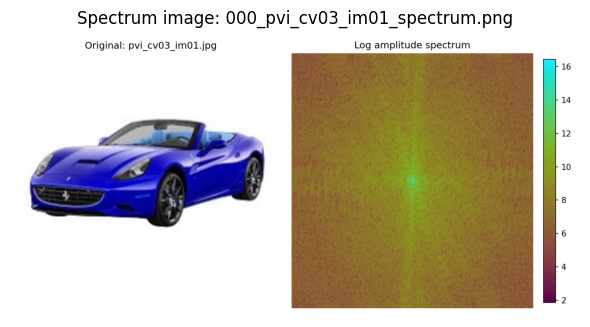

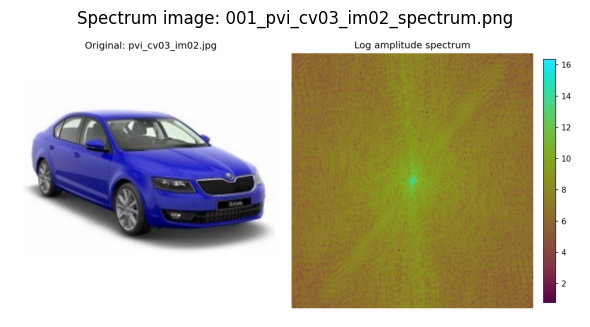

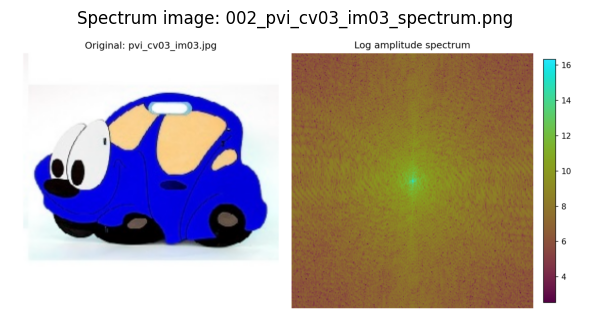

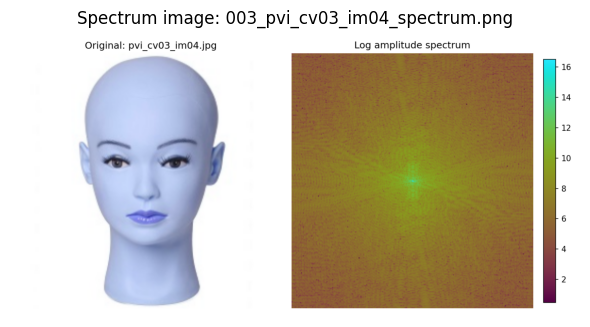

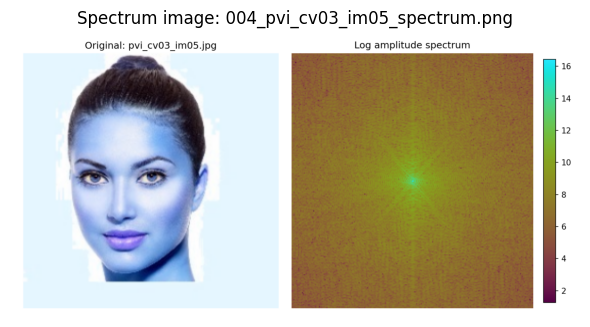

In [4]:
# plot the spectrums from the "spectrums" folder
spectrum_folder = "spectrums"
spectrum_imgs, spectrum_names = load_images_from_folder(spectrum_folder)
print(f"Loaded {len(spectrum_imgs)} spectrum images from {spectrum_folder}")

for i, (img, name) in enumerate(zip(spectrum_imgs, spectrum_names)):
    plt.figure(figsize=(6,5))
    plt.imshow(img, colormap='jet')
    plt.title(f"Spectrum image: {name}")
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    #if i >= 4:  # show only first 5 for brevity
    #    break

Loaded 9 images.
Feature DB shapes -> Gray: (9, 256) Hue: (9, 36) DCT: (9, 25)


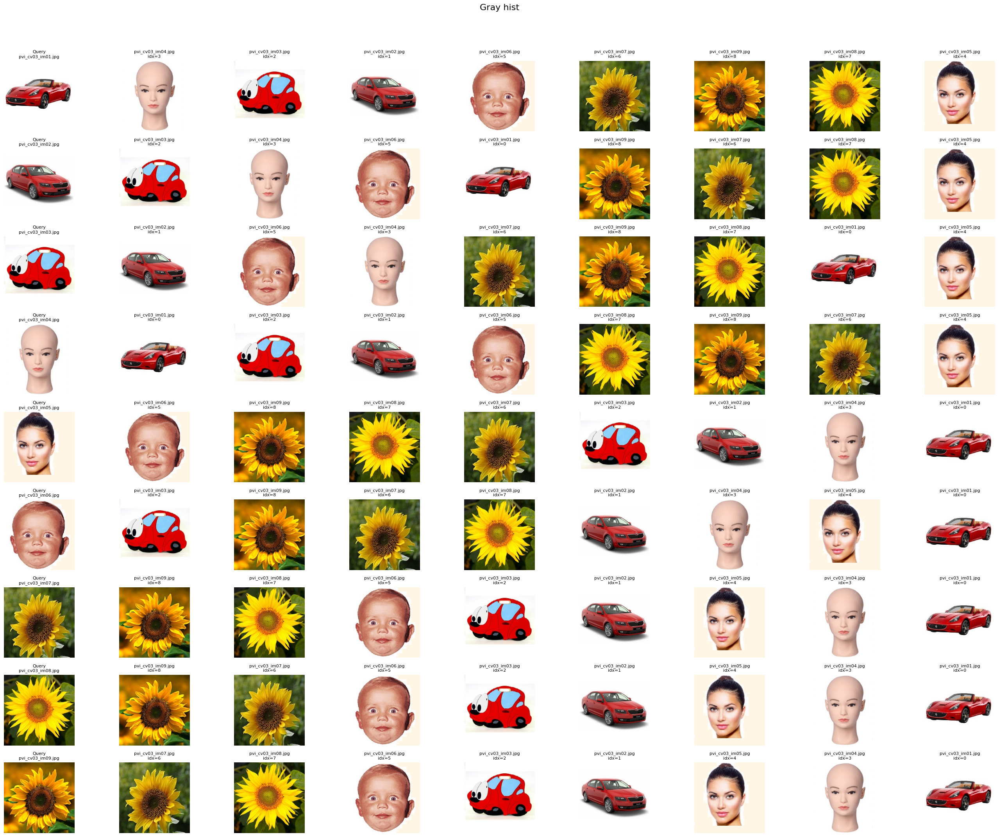

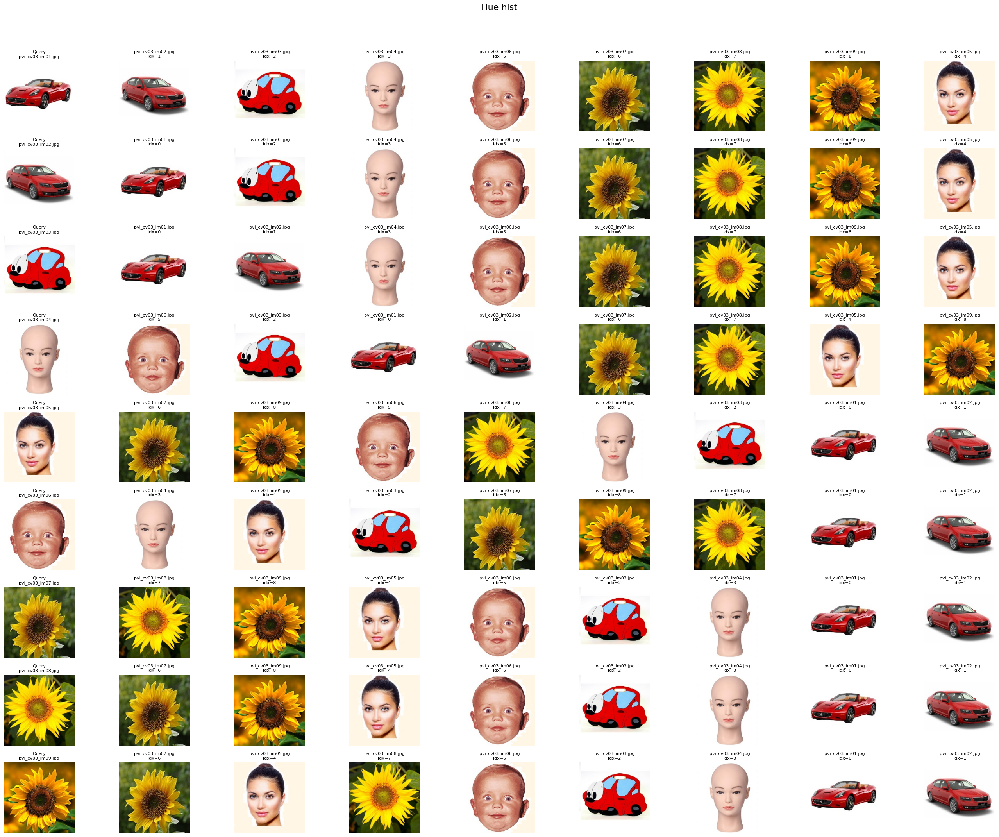

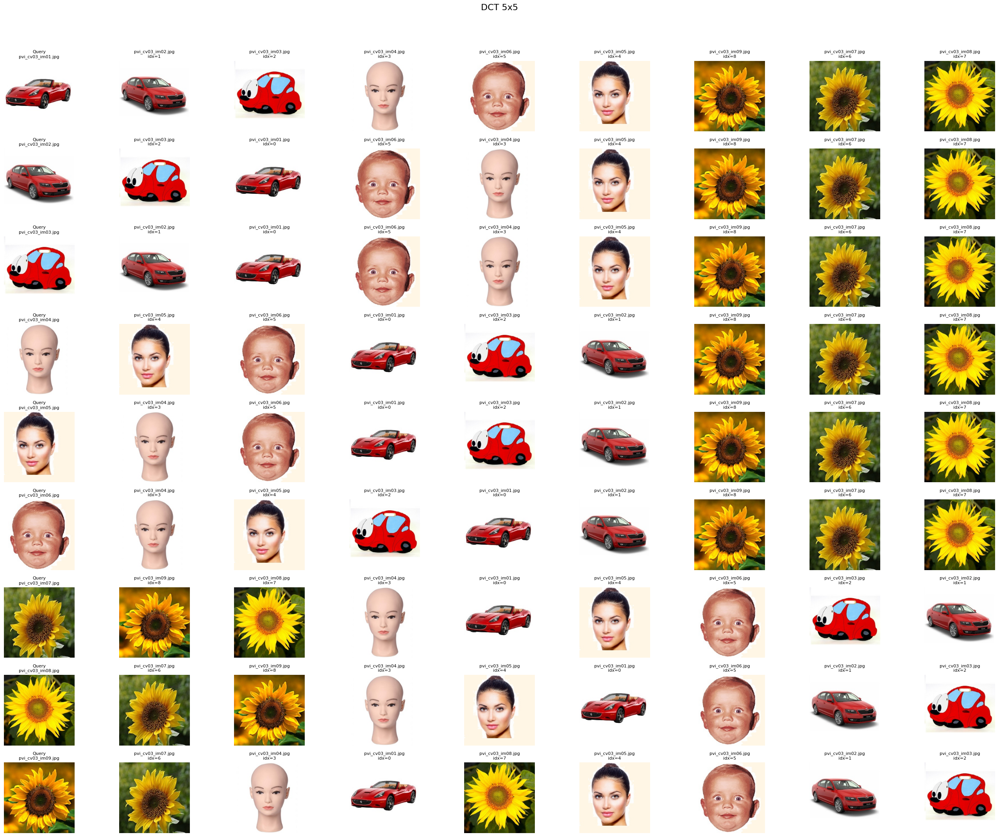

In [6]:
from typing import List

RESIZE_TO = (256, 256)
GRAY_BINS = 256
HUE_BINS = 36
DCT_R = 5
TOPK = 8                     # how many nearest neighbors to show
MAX_QUERIES = None             # how many query images to display (None = all)

def build_feature_db(imgs: List[np.ndarray], resize_to = RESIZE_TO):
    G_list, H_list, D_list = [], [], []
    for img in imgs:
        if resize_to is not None:
            img_res = cv2.resize(img, resize_to, interpolation=cv2.INTER_AREA)
        else:
            img_res = img.copy()
        gray = cv2.cvtColor(img_res, cv2.COLOR_BGR2GRAY)
        G_list.append(hist_gray(gray))
        H_list.append(hist_hue(img_res))
        D_list.append(dct_vector(gray))
    G = np.vstack(G_list)
    H = np.vstack(H_list)
    D = np.vstack(D_list)
    return G, H, D

def query_knn_numpy(vec: np.ndarray, db: np.ndarray, k: int):
    """
    Return indices and distances of k nearest neighbors in db using Euclidean distance.
    """
    # compute L2 distances to every row in db
    diffs = db - vec   # broadcasting
    dists = np.linalg.norm(diffs, axis=1)
    idx = np.argsort(dists)[:k]
    return idx, dists[idx]


def show_results_for_queries(imgs, names, G, H, D, topk=TOPK, max_queries=MAX_QUERIES):
    n = len(imgs)
    queries = list(range(n)) if max_queries is None else list(range(min(n, max_queries)))
    features = [('Gray hist', G), ('Hue hist', H), ('DCT 5x5', D)]

    for feat_name, db in features:
        rows = len(queries)
        cols = topk + 1  # first col = query image
        fig_w = max(3*cols, 8)
        fig_h = max(2.5*rows, 4)
        fig, axes = plt.subplots(rows, cols, figsize=(fig_w, fig_h))
        if rows == 1:
            axes = axes[np.newaxis, :]  # make 2D for consistent indexing
        fig.suptitle(feat_name, fontsize=16)
        for r, qidx in enumerate(queries):
            # prepare query vector
            if feat_name == 'Gray hist':
                qimg_res = cv2.resize(imgs[qidx], RESIZE_TO)
                qgray = cv2.cvtColor(qimg_res, cv2.COLOR_BGR2GRAY)
                qvec = hist_gray(qgray)
            elif feat_name == 'Hue hist':
                qimg_res = cv2.resize(imgs[qidx], RESIZE_TO)
                qvec = hist_hue(qimg_res)
            else:
                qimg_res = cv2.resize(imgs[qidx], RESIZE_TO)
                qgray = cv2.cvtColor(qimg_res, cv2.COLOR_BGR2GRAY)
                qvec = dct_vector(qgray)

            # find k+1 neighbors (likely includes the query itself)
            ksearch = topk + 1
            idxs, dists = query_knn_numpy(qvec, db, k=ksearch)
            # remove query index itself if present
            idxs_list = [int(i) for i in idxs if int(i) != qidx]
            idxs_list = idxs_list[:topk]

            # show the query image in first column
            ax = axes[r, 0]
            ax.imshow(cv2.cvtColor(cv2.resize(imgs[qidx], (200,200)), cv2.COLOR_BGR2RGB))
            ax.set_title(f"Query\n{names[qidx]}", fontsize=8)
            ax.axis('off')

            # show neighbors
            for c in range(topk):
                ax = axes[r, c+1]
                if c < len(idxs_list):
                    ii = idxs_list[c]
                    ax.imshow(cv2.cvtColor(cv2.resize(imgs[ii], (200,200)), cv2.COLOR_BGR2RGB))
                    ax.set_title(f"{names[ii]}\nidx={ii}", fontsize=8)
                else:
                    ax.axis('off')
                ax.axis('off')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()


def main(DATASET_FOLDER="dataset"):
    imgs, names = load_images_from_folder(DATASET_FOLDER)
    if len(imgs) == 0:
        raise RuntimeError(f"No images found in folder: {DATASET_FOLDER}")
    print(f"Loaded {len(imgs)} images.")

    G, H, D = build_feature_db(imgs, resize_to=RESIZE_TO)
    print("Feature DB shapes -> Gray:", G.shape, "Hue:", H.shape, "DCT:", D.shape)

    show_results_for_queries(imgs, names, G, H, D, topk=TOPK, max_queries=MAX_QUERIES)

if __name__ == "__main__":
    # avoid matplotlib warning about many open figures
    import matplotlib
    matplotlib.rcParams['figure.max_open_warning'] = 100
    main()


In [ ]:
def main(DATASET_FOLDER="dataset"):
    imgs, names = load_images_from_folder(DATASET_FOLDER)
    if len(imgs) == 0:
        raise RuntimeError(f"No images found in folder: {DATASET_FOLDER}")
    print(f"Loaded {len(imgs)} images.")

    G, H, D = build_feature_db(imgs, resize_to=RESIZE_TO)
    print("Feature DB shapes -> Gray:", G.shape, "Hue:", H.shape, "DCT:", D.shape)

    show_results_for_queries(imgs, names, G, H, D, topk=TOPK, max_queries=MAX_QUERIES)

if __name__ == "__main__":
    # avoid matplotlib warning about many open figures
    import matplotlib
    matplotlib.rcParams['figure.max_open_warning'] = 100
    main()

In [7]:
# ---- add these helpers near the top of your script ----
eps = 1e-12

def normalize_dists(dists: np.ndarray, method: str = "minmax") -> np.ndarray:
    """
    Normalize a 1D distance array so distances from different features are comparable.
    method: "minmax", "zscore", "rank", "l2"
    Smaller values remain more similar after normalization.
    """
    d = dists.astype(float).copy()
    if method == "minmax":
        mn, mx = d.min(), d.max()
        if mx - mn < eps:
            return np.zeros_like(d)
        return (d - mn) / (mx - mn)
    elif method == "zscore":
        mu, sd = d.mean(), d.std()
        if sd < eps:
            return np.zeros_like(d)
        z = (d - mu) / sd
        zmn, zmx = z.min(), z.max()
        if zmx - zmn < eps:
            return np.zeros_like(z)
        return (z - zmn) / (zmx - zmn)
    elif method == "rank":
        # stable ranking, then normalize to 0..1
        ranks = np.argsort(np.argsort(d))
        return ranks.astype(float) / (len(d) - 1 + eps)
    elif method == "l2":
        norm = np.linalg.norm(d)
        if norm < eps:
            return np.zeros_like(d)
        return d / norm
    else:
        raise ValueError("Unknown normalization method: " + str(method))


def query_knn_numpy_all(vec: np.ndarray, db: np.ndarray) -> np.ndarray:
    """
    Compute Euclidean distances from vec to every row in db and return full 1D array.
    """
    diffs = db - vec
    dists = np.linalg.norm(diffs, axis=1)
    return dists


def fuse_feature_distances(qvecs: dict, dbs: dict, weights: dict = None,
                           norm_method: str = "minmax") -> np.ndarray:
    """
    Given query vectors per-feature and DB matrices per-feature,
    compute normalized distances and return fused distance array (smaller = more similar).
    qvecs: {'gray': vec, 'hue': vec, 'dct': vec}
    dbs:   {'gray': G, 'hue': H, 'dct': D}
    weights: dict or None (equal weights used if None)
    norm_method: normalization method for each feature
    Returns fused (1D array length N)
    """
    feat_names = list(qvecs.keys())
    if weights is None:
        weights = {f: 1.0 for f in feat_names}
    # compute raw & normalized dists
    normed = {}
    for f in feat_names:
        raw = query_knn_numpy_all(qvecs[f], dbs[f])    # shape (N,)
        normed[f] = normalize_dists(raw, method=norm_method)
    # weighted fusion
    fused = np.zeros_like(next(iter(normed.values())), dtype=float)
    total_w = sum(weights.get(f, 0.0) for f in feat_names)
    if total_w == 0.0:
        total_w = 1.0
    for f in feat_names:
        w = float(weights.get(f, 1.0))
        fused += (w / total_w) * normed[f]
    return fused, normed  # return normed for debugging if needed

# ---- replace the old query_knn_numpy with a compatibility wrapper ----
def query_knn_numpy(vec: np.ndarray, db: np.ndarray, k: int):
    """
    Backwards-compatible small helper that returns top-k indices + their raw distances.
    """
    dists = query_knn_numpy_all(vec, db)
    idx = np.argsort(dists)[:k]
    return idx, dists[idx]


# ---- replace show_results_for_queries with fused results capability ----
def show_results_for_queries(imgs, names, G, H, D, topk=TOPK, max_queries=MAX_QUERIES,
                             normalize_method="minmax", weights=None, show_fused=True):
    """
    Displays per-feature grids (Gray, Hue, DCT) as before, and optionally a fused grid using normalized distances.
    normalize_method: "minmax"|"zscore"|"rank"|"l2"
    weights: dict with weights for 'gray','hue','dct' (if None -> equal weights)
    """
    dbs = {'gray': G, 'hue': H, 'dct': D}
    n = len(imgs)
    queries = list(range(n)) if max_queries is None else list(range(min(n, max_queries)))
    features = [('Gray hist', G, 'gray'), ('Hue hist', H, 'hue'), ('DCT 5x5', D, 'dct')]

    # per-feature displays (same as before)
    for feat_name, db, fname in features:
        rows = len(queries)
        cols = topk + 1  # first col = query image
        fig_w = max(3*cols, 8)
        fig_h = max(2.5*rows, 4)
        fig, axes = plt.subplots(rows, cols, figsize=(fig_w, fig_h))
        if rows == 1:
            axes = axes[np.newaxis, :]  # make 2D for consistent indexing
        fig.suptitle(feat_name, fontsize=16)
        for r, qidx in enumerate(queries):
            # prepare query vector
            qimg_res = cv2.resize(imgs[qidx], RESIZE_TO)
            if fname == 'gray':
                qgray = cv2.cvtColor(qimg_res, cv2.COLOR_BGR2GRAY)
                qvec = hist_gray(qgray)
            elif fname == 'hue':
                qvec = hist_hue(qimg_res)
            else:
                qgray = cv2.cvtColor(qimg_res, cv2.COLOR_BGR2GRAY)
                qvec = dct_vector(qgray)

            # find k+1 neighbors (likely includes the query itself)
            ksearch = topk + 1
            idxs, dists = query_knn_numpy(qvec, db, k=ksearch)
            # remove query index itself if present
            idxs_list = [int(i) for i in idxs if int(i) != qidx]
            idxs_list = idxs_list[:topk]

            # show the query image in first column
            ax = axes[r, 0]
            ax.imshow(cv2.cvtColor(cv2.resize(imgs[qidx], (200,200)), cv2.COLOR_BGR2RGB))
            ax.set_title(f"Query\n{names[qidx]}", fontsize=8)
            ax.axis('off')

            # show neighbors
            for c in range(topk):
                ax = axes[r, c+1]
                if c < len(idxs_list):
                    ii = idxs_list[c]
                    ax.imshow(cv2.cvtColor(cv2.resize(imgs[ii], (200,200)), cv2.COLOR_BGR2RGB))
                    ax.set_title(f"{names[ii]}\nidx={ii}", fontsize=8)
                else:
                    ax.axis('off')
                ax.axis('off')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

    # fused display
    if show_fused:
        # prepare a grid like the others but using fused normalized distances
        rows = len(queries)
        cols = topk + 1
        fig_w = max(3*cols, 8)
        fig_h = max(2.5*rows, 4)
        fig, axes = plt.subplots(rows, cols, figsize=(fig_w, fig_h))
        if rows == 1:
            axes = axes[np.newaxis, :]
        fig.suptitle("FUSED (normalized distances)", fontsize=16)

        for r, qidx in enumerate(queries):
            # build query vectors from precomputed DB (faster) to ensure exact same preprocessing
            qvecs = {
                'gray': G[qidx],
                'hue': H[qidx],
                'dct': D[qidx]
            }
            fused, normed = fuse_feature_distances(qvecs, dbs, weights=weights, norm_method=normalize_method)
            # exclude self
            fused[qidx] = np.inf
            idxs = np.argsort(fused)[:topk]

            # show query
            ax = axes[r, 0]
            ax.imshow(cv2.cvtColor(cv2.resize(imgs[qidx], (200,200)), cv2.COLOR_BGR2RGB))
            ax.set_title(f"Query\n{names[qidx]}", fontsize=8)
            ax.axis('off')

            # show fused neighbors
            for c in range(topk):
                ax = axes[r, c+1]
                if c < len(idxs):
                    ii = int(idxs[c])
                    ax.imshow(cv2.cvtColor(cv2.resize(imgs[ii], (200,200)), cv2.COLOR_BGR2RGB))
                    ax.set_title(f"{names[ii]}\nidx={ii}\nscore={fused[ii]:.3f}", fontsize=7)
                else:
                    ax.axis('off')
                ax.axis('off')

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()


Loaded 9 images.
Feature DB shapes -> Gray: (9, 256) Hue: (9, 36) DCT: (9, 25)


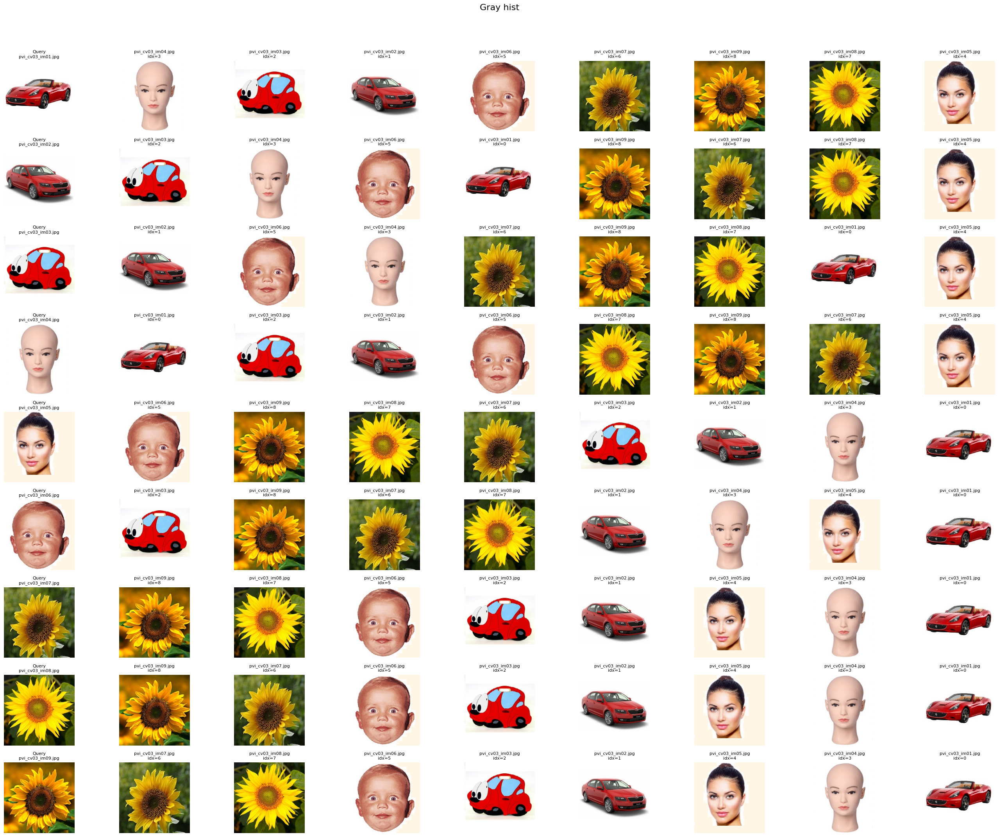

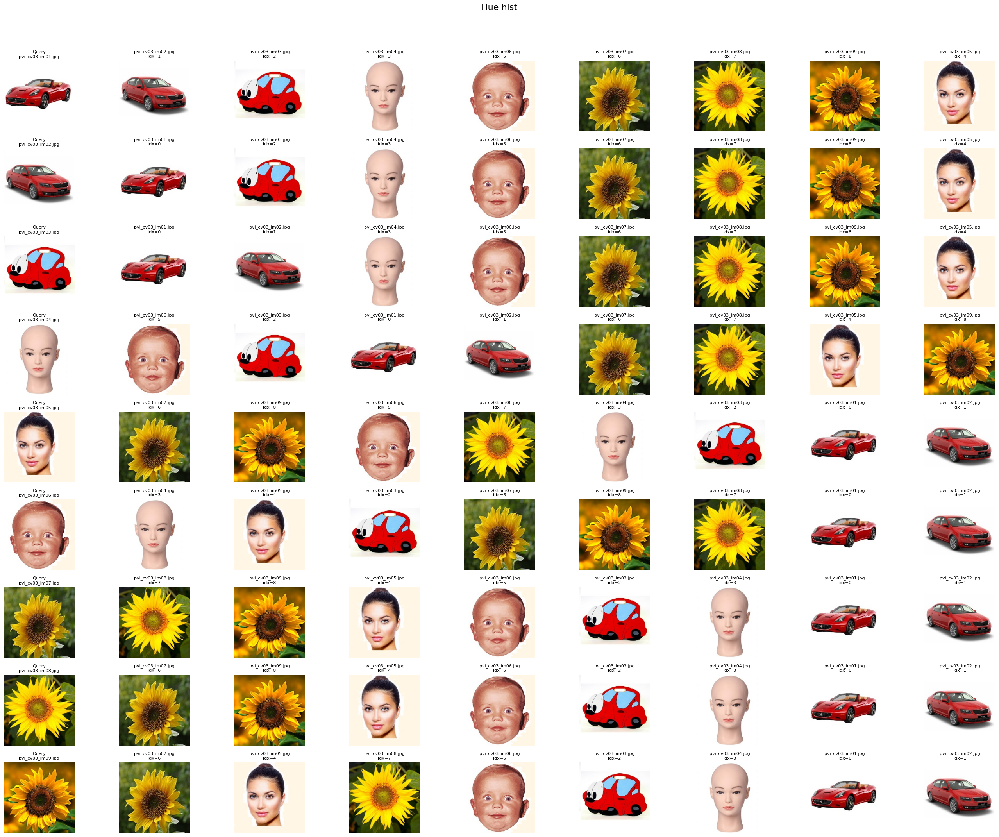

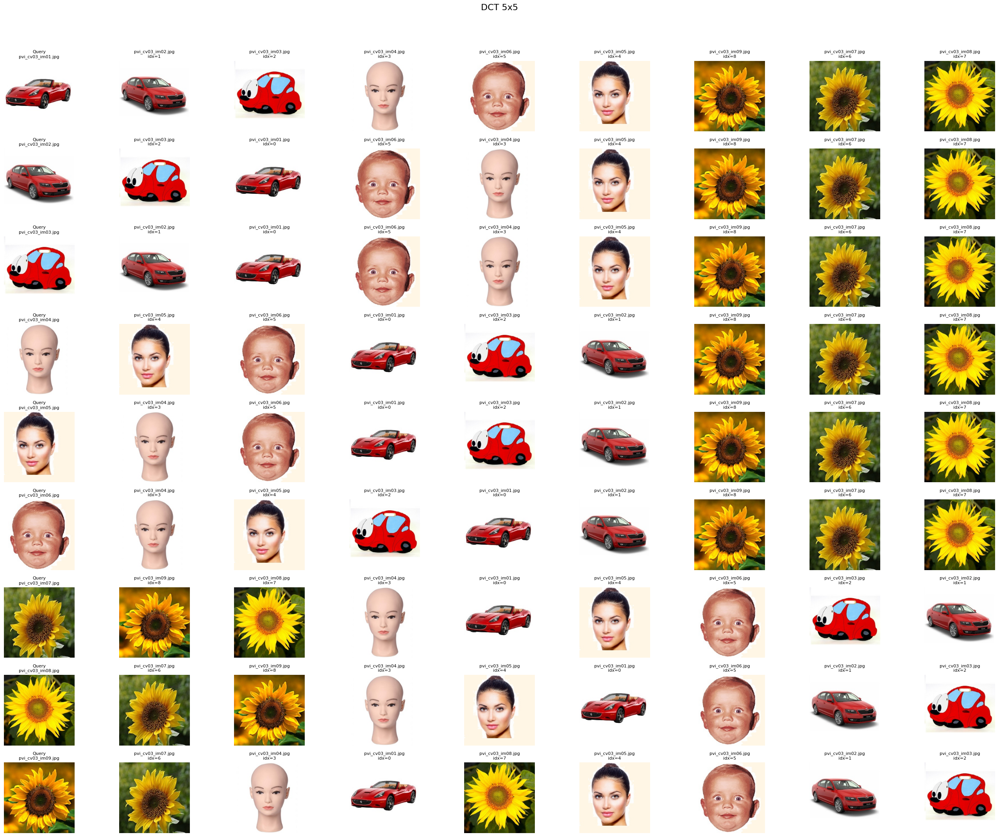

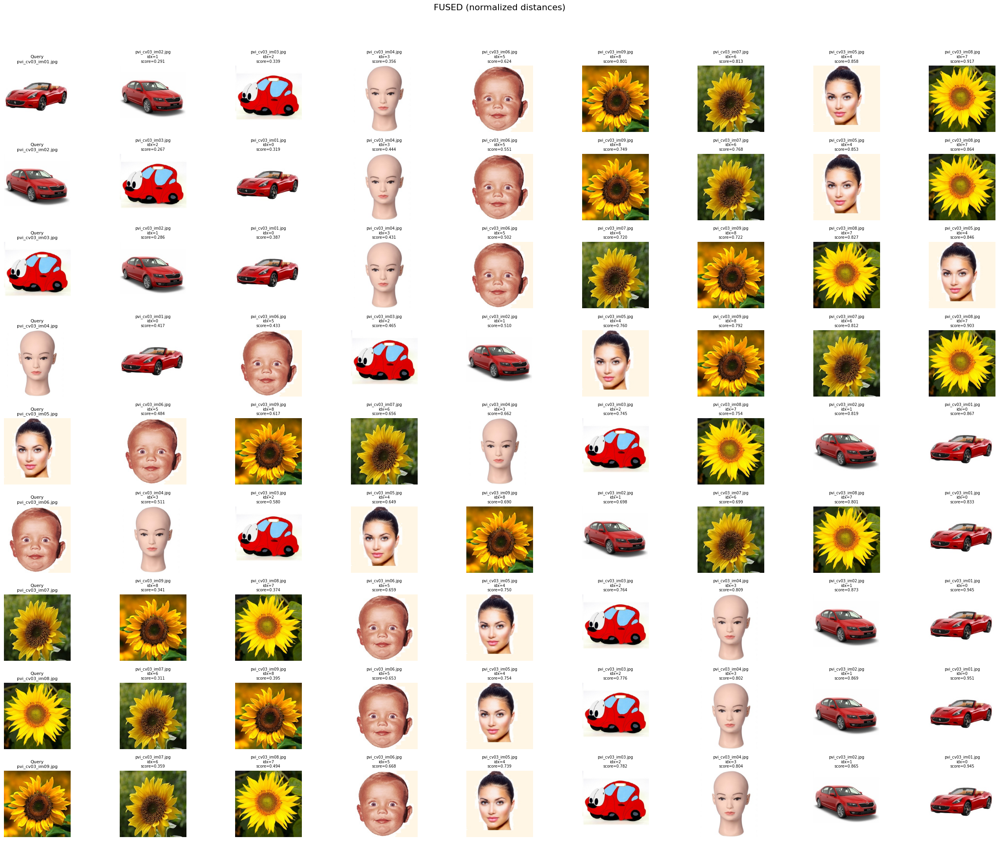

In [8]:
def main(DATASET_FOLDER="dataset"):
    imgs, names = load_images_from_folder(DATASET_FOLDER)
    if len(imgs) == 0:
        raise RuntimeError(f"No images found in folder: {DATASET_FOLDER}")
    print(f"Loaded {len(imgs)} images.")

    G, H, D = build_feature_db(imgs, resize_to=RESIZE_TO)
    print("Feature DB shapes -> Gray:", G.shape, "Hue:", H.shape, "DCT:", D.shape)

    show_results_for_queries(imgs, names, G, H, D, topk=TOPK, max_queries=MAX_QUERIES)

if __name__ == "__main__":
    # avoid matplotlib warning about many open figures
    import matplotlib
    matplotlib.rcParams['figure.max_open_warning'] = 100
    main()